In [204]:
from mung.io import read_nodes_from_file
from mung.graph import NotationGraph
import logging

logger = logging.getLogger()
logger.setLevel(logging.INFO)

nodes = read_nodes_from_file(
    "sandbox-data/4b494e80-4cd2-11ea-a3ba-005056827e52_89218983-dac6-4e8f-9549-05f18d613154.jpg.xml")
print(len(nodes))

graph = NotationGraph(nodes)
graph.remove_vertex(30)

355


In [205]:
# Pitch inference needs all the symbols assigned to some staff.
from mung2midi.inference import InferenceEngineConstants
from mung.node import Node
import numpy as np

staffs = [x for x in graph.vertices if x.class_name == InferenceEngineConstants.STAFF]
staff_centers = np.array([s.top - s.height / 2 for s in staffs])
for node in graph.vertices:
    if node.class_name in InferenceEngineConstants.NOTEHEAD_CLASS_NAMES or node.class_name in InferenceEngineConstants.NOTEHEAD_CLASS_NAMES:
        note_center = node.top - node.height / 2
        distances = np.abs(staff_centers - note_center)
        logging.info(f"Note center: {note_center}, distance: {distances}")
        closest_staff_idx = np.argmin(distances)
        graph.add_edge(node.id, staffs[closest_staff_idx].id)

print(staffs)

INFO:root:Note center: 212.0, distance: [239.5  52.  792. ]
INFO:root:Note center: 211.0, distance: [240.5  51.  793. ]
INFO:root:Note center: 219.5, distance: [232.   59.5 784.5]
INFO:root:Note center: 212.0, distance: [239.5  52.  792. ]
INFO:root:Note center: 196.0, distance: [255.5  36.  808. ]
INFO:root:Note center: 196.0, distance: [255.5  36.  808. ]
INFO:root:Note center: 205.0, distance: [246.5  45.  799. ]
INFO:root:Note center: 210.5, distance: [241.   50.5 793.5]
INFO:root:Note center: 217.5, distance: [234.   57.5 786.5]
INFO:root:Note center: 479.5, distance: [ 28.  319.5 524.5]
INFO:root:Note center: 479.0, distance: [ 27.5 319.  525. ]
INFO:root:Note center: 486.0, distance: [ 34.5 326.  518. ]
INFO:root:Note center: 484.5, distance: [ 33.  324.5 519.5]
INFO:root:Note center: 493.5, distance: [ 42.  333.5 510.5]
INFO:root:Note center: 485.0, distance: [ 33.5 325.  519. ]
INFO:root:Note center: 501.0, distance: [ 49.5 341.  503. ]
INFO:root:Note center: 1070.0, distance:

[<mung.node.Node object at 0x0000019CC2FD6250>, <mung.node.Node object at 0x0000019CCECD6690>, <mung.node.Node object at 0x0000019CDD62C290>]


In [206]:
from mung2midi.inference import PitchInferenceEngine, OnsetsInferenceEngine
from mung2midi.inference import OnsetsInferenceStrategy


class CustomStrategy(OnsetsInferenceStrategy):
    def __init__(self):
        super().__init__()
        self.permissive_desynchronization = True
        self.precedence_only_for_objects_connected_to_staff = False
        self.permissive = True


pitch_inference_engine = PitchInferenceEngine()
time_inference_engine = OnsetsInferenceEngine(nodes, CustomStrategy())

node_id_to_node_mapping = {node.id: node for node in nodes}



In [207]:


logger.setLevel(logging.DEBUG)
onsets = time_inference_engine.onsets(nodes)

print(onsets)

INFO:root:Empty staffs: 
INFO:root:Single-system score, no staff chaining needed.
DEBUG:root:Size of initial queue: 3
DEBUG:root:Initial queue: [(21, 0), (50, 0), (83, 0)]
DEBUG:root:Current @0: 21
DEBUG:root:Will add @0: [<mung2midi.inference.PrecedenceGraphNode object at 0x0000019CDD6B0D10>, <mung2midi.inference.PrecedenceGraphNode object at 0x0000019CDDE8AC10>]
DEBUG:root:Queue state: [50, 83, 22, 23]
DEBUG:root:  21 has onset: 0
DEBUG:root:Current @1: 50
DEBUG:root:Will add @1: [<mung2midi.inference.PrecedenceGraphNode object at 0x0000019CDF022810>]
DEBUG:root:Queue state: [83, 22, 23, 51]
DEBUG:root:  50 has onset: 0
DEBUG:root:Current @2: 83
DEBUG:root:Will add @2: [<mung2midi.inference.PrecedenceGraphNode object at 0x0000019CDB744710>]
DEBUG:root:Queue state: [22, 23, 51, 84]
DEBUG:root:  83 has onset: 0
DEBUG:root:Current @3: 22
DEBUG:root:Will add @3: [<mung2midi.inference.PrecedenceGraphNode object at 0x0000019CDDE8AC10>]
DEBUG:root:Queue state: [23, 51, 84]
DEBUG:root:  22 h

{21: 0, 50: 0, 83: 0, 22: 1, 23: 1.5, 51: 0.5, 84: 1.0, 24: 2.0, 56: 2.0, 85: 1.5, 34: 2.5, 57: 2.5, 91: 2.0, 35: 3.0, 58: 3.0, 92: 3.0, 36: 3.5, 65: 3.5, 93: 3.5, 37: 4.0, 68: 4.0, 94: 4.0, 46: 4.5, 352: 5.0, 95: 4.5, 105: 5.0, 106: 6.0, 353: 7.0}


In [208]:
durations = time_inference_engine.durations(nodes)
print(durations)

{21: 1, 22: 0.5, 23: 0.5, 24: 0.5, 34: 0.5, 35: 0.5, 36: 0.5, 37: 0.5, 46: 2, 50: 0.5, 51: 1.5, 56: 0.5, 57: 0.5, 58: 0.5, 65: 0.5, 68: 1.0, 83: 1.0, 84: 0.5, 85: 0.5, 91: 1.0, 92: 0.5, 93: 0.5, 94: 0.5, 95: 0.5, 105: 1.0, 106: 1.0, 352: 1, 353: 1}


In [209]:

# logger.setLevel(logging.DEBUG)
#
# pitches, pitch_names = pitch_inference_engine.infer_pitches(nodes, with_names=True)
# print(pitches)
# print(pitch_names)

In [210]:
# Testing of onset inference with custom algorithm and classes
# Current implementation

from mung.io import read_nodes_from_file
from mung.graph import NotationGraph, Node
import logging
from IPython.display import display

logger = logging.getLogger()
logger.setLevel(logging.INFO)
from dataclasses import dataclass
from PIL import Image
import matplotlib.pyplot as plt


@dataclass(frozen=True)
class Rectangle:
    top: int
    left: int
    bottom: int
    right: int


def filter_graph(graph: NotationGraph, zone: Rectangle):
    def is_in(node: Node, zone: Rectangle):
        return (
                node.left >= zone.left and
                node.right <= zone.right and
                node.top >= zone.top and
                node.bottom <= zone.bottom
        )

    logging.info(f"Node count before filtering: {len(graph.vertices)}")

    to_remove = [node for node in graph.vertices if not is_in(node, zone)]
    for node in to_remove:
        graph.remove_vertex(node.id)

    logging.info(f"Node count after filtering: {len(graph.vertices)}")


zone = Rectangle(2027, 413, 2605, 3103)
zone = Rectangle(1450, 333, 2000, 3103)
zone = Rectangle(0, 0, 4010, 3364)

annot_path = "sandbox-data/1d507bc2-87e7-4b61-8bea-6126616c4851_16e3cbb5-bd89-48c2-80a6-cccbcaeb7893.jpg.xml"
image_path = annot_path.split(".")[0] + ".png"
nodes = read_nodes_from_file(annot_path)

graph = NotationGraph(nodes)
filter_graph(graph, zone)

image = Image.open(image_path)
cropped_image = image.crop((zone.left, zone.top, zone.right, zone.bottom))

# display(cropped_image)

INFO:root:Node count before filtering: 1453
INFO:root:Node count after filtering: 1453


In [211]:
from dataclasses import dataclass
from PIL import Image, ImageDraw
from IPython.display import display

draw = ImageDraw.Draw(image)
for node in graph.vertices:
    box = (node.left, node.top, node.right, node.bottom)
    draw.rectangle(box, outline="red", width=2)  # Only outline

# Show the image
# display(image.crop((zone.left, zone.top, zone.right, zone.bottom)))

print(graph[1373].precedence_inlinks, graph[1373].precedence_outlinks)
print(graph[431].precedence_inlinks, graph[431].precedence_outlinks)
print(graph[432].precedence_inlinks, graph[432].precedence_outlinks)

[] []
[] [432]
[431] [433]


In [212]:
from mung2midi.inference import InferenceEngineConstants, OnsetsInferenceStrategy, OnsetsInferenceEngine

from mung2midi.inference import PitchInferenceEngine, OnsetsInferenceEngine
from mung2midi.inference import OnsetsInferenceStrategy


class CustomStrategy(OnsetsInferenceStrategy):
    def __init__(self):
        super().__init__()
        self.permissive_desynchronization = True
        self.precedence_only_for_objects_connected_to_staff = False
        self.permissive = True


pitch_inference_engine = PitchInferenceEngine()
time_inference_engine = OnsetsInferenceEngine(graph.vertices, CustomStrategy())
raw_onsets = time_inference_engine.onsets(graph.vertices)

INFO:root:Empty staffs: 647
648
649
650
651
652
653
654
655
656
657
658
INFO:root:Single-system score, no staff chaining needed.


In [213]:
from PIL import ImageDraw, ImageFont

from PIL import ImageDraw, ImageFont


def annotate_nodes_with_values(image, nodes, values_dict, text_color="red", font_size=28, reference_dict=None):
    """
    Annotates nodes on the image with their corresponding values from values_dict.
    If reference_dict is provided, nodes with differing values are highlighted in green.

    Parameters:
    - image: PIL Image
    - nodes: List of Node objects (must have .id, .left, .right, .top, .bottom)
    - values_dict: Dict of node.id -> value (to annotate)
    - text_color: Default text color for matching values
    - font_size: Font size for the text
    - reference_dict: Optional dict to compare values against
    """
    draw = ImageDraw.Draw(image)

    try:
        font = ImageFont.truetype("arial.ttf", font_size)
    except IOError:
        font = ImageFont.load_default()
        print("⚠️ Could not load truetype font; using default (size may be small).")

    for node in nodes:
        if node.id in values_dict:
            value = values_dict[node.id]

            # Use green if different from reference_dict
            color = text_color
            if reference_dict and node.id in reference_dict:
                if reference_dict[node.id] != value:
                    color = "green"

            x = (node.left + node.right) // 2
            y = (node.top + node.bottom) // 2
            draw.text((x, y), str(value), fill=color, font=font, anchor="mm")


image = Image.open(image_path)
annotate_nodes_with_values(image, graph.vertices, raw_onsets)
# display(image.crop((zone.left, zone.top, zone.right, zone.bottom)))


In [214]:
from mung2midi.inference import InferenceEngineConstants
from typing import Any

logger.setLevel(logging.DEBUG)


def flatten(xss: list[list[Any]]):
    return [x for xs in xss for x in xs]


def fix_missing_stems_for_full_noteheads(graph: NotationGraph):
    """
    *This is guess work based on heuristics, and it might make mistakes.*

    All strategies assume that everything else in the graph is correct
    and that all stems are correctly detected and classified.
    """
    # Find all full noteheads that are missing a stem
    full_noteheads = [node for node in graph.vertices if node.class_name == InferenceEngineConstants.NOTEHEAD_FULL]
    corrupted_fn = [fn for fn in full_noteheads if len(graph.children(fn, [InferenceEngineConstants.STEM])) == 0]
    for fn in corrupted_fn:
        logging.warning(f"Full notehead {fn.id} has no stem")

    """
    Strategy 1:
        - Find all preceding noteheads.
        - Find their succeeding noteheads - if all assumptions above hold,
            these noteheads should have the same onset as the corrupted notehead.
        - Similarly for succeeding noteheads.
        - If only one stems is found, it should be the one we are looking for.
        - This strategy is the most reliable one.

    TODO: Introduce more strategies. Maybe "closest one".
    """

    def strategy_n1(graph: NotationGraph, full_notehead: Node) -> list[Node]:
        # Preceding and succeeding noteheads
        prec_noteheads = [graph[_id] for _id in full_notehead.precedence_inlinks]
        succ_noteheads = [graph[_id] for _id in full_notehead.precedence_outlinks]
        same_onset = set(flatten([pn.precedence_outlinks for pn in prec_noteheads]) + flatten(
            [sn.precedence_inlinks for sn in succ_noteheads]))
        same_onset.discard(full_notehead.id)
        logging.debug(f"Noteheads with possibly same onset: {same_onset}")

        # Retrieve stem IDs connected to noteheads with possibly the same onset
        stems: set[Node] = set(
            flatten([graph.children(notehead, [InferenceEngineConstants.STEM]) for notehead in same_onset]))
        return list(stems)

    for fn in corrupted_fn:
        logging.info(f"Trying to resolve full notehead {fn.id}")
        possible_stems = strategy_n1(graph, fn)
        if len(possible_stems) == 1:
            graph.add_edge(fn.id, possible_stems[0].id)
            logging.info(f"Full notehead {fn.id} resolved, connected to stem {possible_stems[0].id}")

        logging.info(f"Could not resolve full notehead {fn.id}")


fix_missing_stems_for_full_noteheads(graph)

INFO:root:Trying to resolve full notehead 27
DEBUG:root:Noteheads with possibly same onset: {26, 28}
INFO:root:Full notehead 27 resolved, connected to stem 210
INFO:root:Could not resolve full notehead 27
INFO:root:Trying to resolve full notehead 29
DEBUG:root:Noteheads with possibly same onset: set()
INFO:root:Could not resolve full notehead 29
INFO:root:Trying to resolve full notehead 544
DEBUG:root:Noteheads with possibly same onset: set()
INFO:root:Could not resolve full notehead 544
INFO:root:Trying to resolve full notehead 748
DEBUG:root:Noteheads with possibly same onset: {16, 17}
INFO:root:Full notehead 748 resolved, connected to stem 191
INFO:root:Could not resolve full notehead 748


In [215]:
from mung2midi.inference import InferenceEngineConstants
from mung.constants import PrecedenceLinksConstants
from mung.graph import NotationGraph, Node
from typing import Optional

logger.setLevel(logging.INFO)


def fix_missing_precedence_edges_based_on_stems(graph: NotationGraph):
    """
    Ensures that noteheads connected by the same stem share a common onset by fixing missing precedence edges.

    For each group of noteheads connected to the same stem (i.e., forming a chord), if at least one notehead has
    an incoming precedence edge, any other noteheads in the group without any precedence edge will be connected to
    that same preceding notehead. This helps maintain consistency in onset timing within chords.

    :param graph: ``NotationGraph`` instance, edges are added in place
    """

    def get_notehead_linked_by_stem(graph: NotationGraph) -> list[list[Node]]:
        stems = [x for x in graph.vertices if x.class_name == InferenceEngineConstants.STEM]
        logging.debug(f"Found {len(stems)} stems")
        output: list[list[Node]] = []
        for stem in stems:
            output.append(graph.parents(stem, InferenceEngineConstants.NOTEHEAD_CLASS_NAMES))
        return output

    def has_precedence_inlinks(node: Node) -> bool:
        return len(node.precedence_inlinks) > 0

    def find_precedence_parent_id_in_chord(chord: list[Node]) -> Optional[int]:
        """
        Returns the first found precedence parent for any notehead inside a chord.
        If no precedence parent is found, returns None.
        """
        for notehead in chord:
            if has_precedence_inlinks(notehead):
                return notehead.precedence_inlinks[0]
        return None

    noteheads_by_chords = get_notehead_linked_by_stem(graph)
    # Filter out "chords" with only one notehead.
    # There is nothing we can do to fill in missing precedence edges, if it is missing any.
    noteheads_by_chords = [nc for nc in noteheads_by_chords if len(nc) > 1]

    total_added = 0
    for chord in noteheads_by_chords:
        for notehead in chord:
            if not has_precedence_inlinks(notehead):
                predecessor_id = find_precedence_parent_id_in_chord(chord)
                if predecessor_id is not None:
                    graph.add_precedence_edge(predecessor_id, notehead.id)
                    logging.debug(f"Adding precedence edge: {predecessor_id} -> {notehead.id}")
                    total_added += 1
    logging.info(f"Added {total_added} missing precedence edges")


fix_missing_precedence_edges_based_on_stems(graph)

INFO:root:Added 86 missing precedence edges


INFO:root:Empty staffs: 647
648
649
650
651
652
653
654
655
656
657
658
INFO:root:Single-system score, no staff chaining needed.


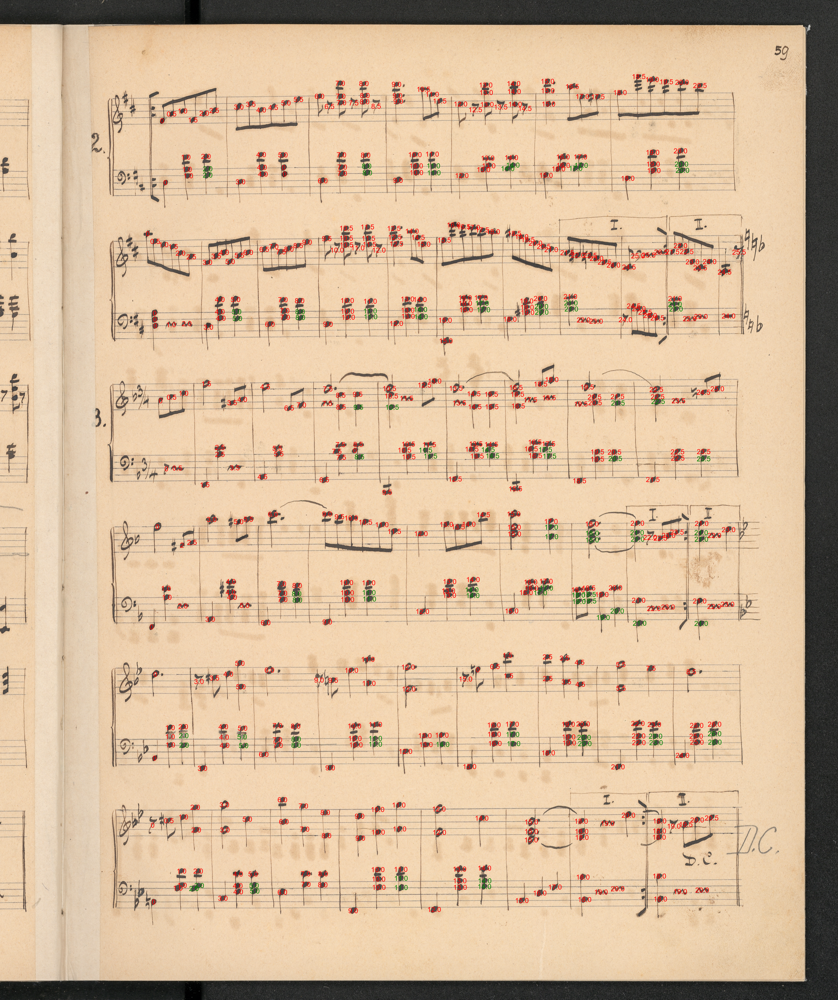

In [216]:
time_inference_engine = OnsetsInferenceEngine(graph.vertices, CustomStrategy())
fixed_onsets = time_inference_engine.onsets(graph.vertices)

image = Image.open(image_path)
annotate_nodes_with_values(image, graph.vertices, fixed_onsets, reference_dict=raw_onsets)
display(image.crop((zone.left, zone.top, zone.right, zone.bottom)))

In [217]:
import numpy as np


def display_mask(mask: np.ndarray):
    assert mask.dtype == np.uint8 and mask.ndim == 2
    img = Image.fromarray(mask * 255, mode='L')
    display(img)


staff_lines = [x for x in graph.vertices if x.class_name == InferenceEngineConstants.STAFFLINE]

for staff_line in staff_lines[0:2]:
    print(staff_line.left, staff_line.right)
    print(staff_line.width, staff_line.height)
    print(staff_line.mask.shape)
    image_data = staff_line.mask * 255
    img = Image.fromarray(image_data[..., 0:200], mode='L')
    # print(image_data[20:,0:200])
    display(img)


def create_average_mask(firsts1, counts1, firsts2, counts2):
    """
    Creates a binary mask by averaging two sets of (first_position, count) arrays.
    The mask contains 1s in each column starting at the average first position
    and spanning the average count.

    All averages are rounded to the nearest integer.

    Parameters:
    - firsts1, firsts2: 1D arrays of first 1 positions (int, -1 if missing)
    - counts1, counts2: 1D arrays of 1 counts (int)

    Returns:
    - mask: 2D numpy array of shape (height, width)
    """
    assert len(firsts1) == len(firsts2) == len(counts1) == len(counts2), "Mismatched input lengths"
    width = len(firsts1)

    # Compute average positions and counts
    avg_firsts = np.round((firsts1 + firsts2) / 2).astype(int)
    avg_counts = np.round((counts1 + counts2) / 2).astype(int)

    # Compute mask height
    max_bottom = np.max(avg_firsts + avg_counts)
    height = max_bottom if max_bottom > 0 else 1

    # Create the binary mask
    mask = np.zeros((height, width), dtype=np.uint8)

    for col in range(width):
        start = avg_firsts[col]
        count = avg_counts[col]
        if start >= 0 and count > 0:
            end = min(start + count, height)
            mask[start:end, col] = 1

    return mask


import numpy as np

import numpy as np


def first_position_and_counts_per_column(matrix: np.ndarray):
    """
    For each column in the binary matrix:
    - Finds the row index of the first 1 (from top).
    - Counts the number of 1s.

    Parameters:
    - matrix: 2D numpy array of 0s and 1s

    Returns:
    - first_positions: 1D float array (np.nan if no 1s in column)
    - counts: 1D int array with number of 1s per column
    """
    rows, cols = matrix.shape
    counts = matrix.sum(axis=0)

    # Initialize with NaNs (for columns with no 1s)
    first_positions = np.full(cols, -1, dtype=int)

    for col in range(cols):
        ones = np.where(matrix[:, col] == 1)[0]
        if ones.size > 0:
            first_positions[col] = ones[0]
        else:
            logging.warning(f"No 1s found in column {col}")

    return first_positions, counts


def crop_node_masks_to_horizontal_overlap(node1: Node, node2: Node):
    left_start = max(node1.left, node2.left)
    right_end = min(node1.right, node2.right)
    if left_start >= right_end:
        logging.warning(f"Given nodes {node1.id}, {node2.id} do not vertically overlap")
        return None

    mask1 = node1.mask[..., left_start - node1.left: node1.mask.shape[1] - (node1.right - right_end)]
    mask2 = node2.mask[..., left_start - node2.left: node2.mask.shape[1] - (node2.right - right_end)]

    # new masks should have the same length
    assert mask1.shape[1] == mask2.shape[1]

    return mask1, mask2


import numpy as np
from PIL import Image


def draw_mask_on_image(image: Image.Image, mask: np.ndarray, top: int, left: int, color=(255, 0, 0)):
    """
    Draws a binary mask (2D array of 0s and 1s) onto an RGB image at the specified top-left position.

    Parameters:
    - image: PIL.Image (mode='RGB')
    - mask: 2D numpy array of 0s and 1s
    - top, left: coordinates to place the mask
    - color: RGB tuple for the mask (default: red)

    Returns:
    - image_with_mask: PIL.Image with mask drawn on it
    """
    img_np = np.array(image)

    h, w = mask.shape
    img_h, img_w = img_np.shape[:2]

    # Compute overlapping region
    y_start = max(top, 0)
    y_end = min(top + h, img_h)
    x_start = max(left, 0)
    x_end = min(left + w, img_w)

    # Compute slice ranges in mask
    mask_y_start = y_start - top
    mask_y_end = mask_y_start + (y_end - y_start)
    mask_x_start = x_start - left
    mask_x_end = mask_x_start + (x_end - x_start)

    # Apply mask
    if y_start < y_end and x_start < x_end:
        region = mask[mask_y_start:mask_y_end, mask_x_start:mask_x_end].astype(bool)
        img_np[y_start:y_end, x_start:x_end][region] = color

    return Image.fromarray(img_np)


for i in range(len(staff_lines[:6]) - 1):
    mask1, mask2 = crop_node_masks_to_horizontal_overlap(staff_lines[i], staff_lines[i + 1])
    fp1, c1 = first_position_and_counts_per_column(mask1)
    fp2, c2 = first_position_and_counts_per_column(mask2)
    mask_avg = create_average_mask(fp1, c1, fp2, c2)

    top, left = int((staff_lines[i].top + staff_lines[i + 1].top) / 2), int(
        (staff_lines[i].left + staff_lines[i + 1].left) / 2)

    display_mask(mask1)
    display_mask(mask_avg)
    display_mask(mask2)
    print("----")




449 2949
2500 24
(24, 2500)


449 2944
2495 24
(24, 2495)


----


----


----


----


----


In [218]:
staff_lines: list[Node] = sorted([x for x in graph.vertices if x.class_name == InferenceEngineConstants.STAFFLINE],
                                 key=lambda x: x.top)
noteheads: list[Node] = [x for x in graph.vertices if x.class_name in InferenceEngineConstants.NOTEHEAD_CLASS_NAMES]

from PIL import ImageDraw

WESTERN_NOTATION_STAFF_LINE_COUNT = 5


class IDGenerator:
    def __init__(self, start: int = 0):
        self.__counter = start

    def get_next(self) -> int:
        """
        Returns the next unique ID and increments the counter.
        """
        current = self.__counter
        self.__counter += 1
        return current

    def reset(self, value: int = 0) -> None:
        """
        Resets the counter to a specific value (default is 0).
        """
        self.__counter = value


def create_staffspaces_for_single_staff_as_lines(staff_lines: list[Node]) -> list[Node]:
    assert len(staff_lines) == WESTERN_NOTATION_STAFF_LINE_COUNT
    staff_spaces: list[Node] = []
    for i in range(len(staff_lines) - 1):
        mask1, mask2 = crop_node_masks_to_horizontal_overlap(staff_lines[i], staff_lines[i + 1])
        fp1, c1 = first_position_and_counts_per_column(mask1)
        fp2, c2 = first_position_and_counts_per_column(mask2)
        mask_avg = create_average_mask(fp1, c1, fp2, c2)

        top = int((staff_lines[i].top + staff_lines[i + 1].top) / 2)
        left = int((staff_lines[i].left + staff_lines[i + 1].left) / 2)

        # staff_spaces.append(
        #     Node(
        #
        #     )
        # )
        raise NotImplementedError()


def create_staff_space_for_staff(staff_lines: list[Node]) -> list[Node]:
    pass


# Coordinates of the red blob (adjust as needed)
for staff_line in staff_lines:
    # Convert to PIL image (mode 'L' = grayscale)
    image_data = staff_line.mask * 255
    img = Image.fromarray(image_data, mode='L')
    # Convert to RGB so we can add color
    img_rgb = img.convert("RGB")
    # Draw on the image
    draw = ImageDraw.Draw(img_rgb)
    for notehead in noteheads:
        blob_center = (notehead.middle[1] - staff_line.left, notehead.middle[0] - staff_line.top)
        # print(blob_center)
        blob_radius = 10
        bbox = [
            blob_center[0] - blob_radius,
            blob_center[1] - blob_radius,
            blob_center[0] + blob_radius,
            blob_center[1] + blob_radius
        ]

        # Draw a filled red circle
        draw.ellipse(bbox, fill="red")

    # Display result
    display(img_rgb)
    break


In [219]:
import logging

logger = logging.getLogger()
logger.setLevel(logging.INFO)

from mung import NotationGraph, Node, stafflines
from mung.constants import InferenceEngineConstants
from IPython.display import display
from PIL import Image, ImageDraw
from IPython.display import display
from mung.io import validate_nodes_graph_structure
import numpy as np

#
# graph = NotationGraph.from_file(
#     "mung2midi/sample/CVC-MUSCIMA_W-01_N-10_D-ideal.xml")

from mung.stafflines import build_staffspace_nodes, build_staff_nodes

WESTERN_NOTATION_STAFF_LINE_COUNT = 5


class StafflineCountNotMultiple(ValueError):
    def __init__(self):
        message = f"Provided staffline count is not a multiple of {WESTERN_NOTATION_STAFF_LINE_COUNT}"
        super().__init__(message)


logger.setLevel(logging.DEBUG)


def display_mask(mask: np.ndarray):
    assert mask.dtype == np.uint8 and mask.ndim == 2
    img = Image.fromarray(mask * 255, mode='L')
    display(img)


def _build_or_check_existing_staff_to_staffline_links(graph: NotationGraph):
    """
    Cheks existing connections between staffs and stafflines. Graph is modified in place.

    If a connection exists:
    - There should be only one.
    - It should match the computed connection.

    If it does not exist, stafflines are grouped into groups of five from top to bottom
    and assigned to their respective staff.
    """
    staffs = sorted(graph.filter_vertices(InferenceEngineConstants.STAFF), key=lambda x: x.top)
    stafflines = sorted(graph.filter_vertices(InferenceEngineConstants.STAFFLINE), key=lambda x: x.top)

    assert len(stafflines) % len(staffs) == 0

    for i, staffline in enumerate(stafflines):
        # Staff index relative from top to bottom (index of upper staff is 0)
        relative_staff_index = i // WESTERN_NOTATION_STAFF_LINE_COUNT
        assigned_staffs = graph.parents(staffline.id, class_filter=[InferenceEngineConstants.STAFF])

        if len(assigned_staffs) > 1:
            raise ValueError(f"Staffline {staffline.id} has multiple assigned staffs")

        proposed_staff_id = staffs[relative_staff_index].id

        # is assigned to something, just check that it is correct
        if len(assigned_staffs) == 1:
            current_staff_id = assigned_staffs[0].id
            if current_staff_id != proposed_staff_id:
                logger.warning(
                    f"Staffline {staffline.id} is assigned to staff {current_staff_id} which differs from computed {proposed_staff_id}")
        # is not assigned to anything, assign it by sort
        else:
            graph.add_edge(proposed_staff_id, staffline.id)
            logger.debug(f"Creating edge from staff {proposed_staff_id} to staffline {staffline.id}")


def build_or_link_stafflines_to_staffs(graph: NotationGraph) -> NotationGraph:
    """
    Builds a new instance of ``NotationGraph`` with filled in missing staffs
    and staff to staffline links.

    :param graph: graph to which the staffs and links will be added
    :return: new instance of ``NotationGraph``
    """
    staffline_c = len(graph.filter_vertices(InferenceEngineConstants.STAFFLINE))
    staff_c = len(graph.filter_vertices(InferenceEngineConstants.STAFF))
    logger.debug(f"{staffline_c=}, {staff_c=}")

    # Check staffline counts
    if staffline_c % WESTERN_NOTATION_STAFF_LINE_COUNT != 0:
        raise StafflineCountNotMultiple()

    # Some staffs were provided, counts do not match
    if staff_c > 0 and WESTERN_NOTATION_STAFF_LINE_COUNT * staff_c != staffline_c:
        raise ValueError(
            f"Expected staffline count {WESTERN_NOTATION_STAFF_LINE_COUNT * staff_c} does not match with staffline count given {staffline_c}"
        )

    logger.debug("Staff and staffline checks passed")

    if staff_c > 0:
        _build_or_check_existing_staff_to_staffline_links(graph)
        new_graph = NotationGraph(graph.vertices)
    else:
        staffs = build_staff_nodes(graph.vertices)
        logging.info(f"Added {len(staffs)} staffs")

        assert len(staffs) * WESTERN_NOTATION_STAFF_LINE_COUNT == staffline_c

        all_nodes = graph.vertices + staffs

        new_graph = NotationGraph(all_nodes)

    assert validate_nodes_graph_structure(new_graph.vertices)
    return new_graph


annot_path = "sandbox-data/1d507bc2-87e7-4b61-8bea-6126616c4851_16e3cbb5-bd89-48c2-80a6-cccbcaeb7893.jpg.xml"
# annot_path = "sandbox-data/4b494e80-4cd2-11ea-a3ba-005056827e52_89218983-dac6-4e8f-9549-05f18d613154.jpg.xml"

image_path = annot_path.split(".")[0] + ".png"
image = Image.open(image_path)
draw = ImageDraw.Draw(image)

graph = NotationGraph.from_file(annot_path)

# To test staff autofill
# graph.remove_classes([InferenceEngineConstants.STAFF])

graph = build_or_link_stafflines_to_staffs(graph)

logger.setLevel(logging.INFO)

DEBUG:PIL.PngImagePlugin:STREAM b'IHDR' 16 13
DEBUG:PIL.PngImagePlugin:STREAM b'pHYs' 41 9
DEBUG:PIL.PngImagePlugin:STREAM b'tEXt' 62 19
DEBUG:PIL.PngImagePlugin:STREAM b'IDAT' 93 8192
DEBUG:root:XML parsed.
DEBUG:root:Parsing Node 0
DEBUG:root:Parsing Node 1
DEBUG:root:Parsing Node 2
DEBUG:root:Parsing Node 3
DEBUG:root:Parsing Node 4
DEBUG:root:Parsing Node 5
DEBUG:root:Parsing Node 6
DEBUG:root:Parsing Node 7
DEBUG:root:Parsing Node 8
DEBUG:root:Parsing Node 9
DEBUG:root:Parsing Node 10
DEBUG:root:Parsing Node 11
DEBUG:root:Parsing Node 12
DEBUG:root:Parsing Node 13
DEBUG:root:Parsing Node 14
DEBUG:root:Parsing Node 15
DEBUG:root:Parsing Node 16
DEBUG:root:Parsing Node 17
DEBUG:root:Parsing Node 18
DEBUG:root:Parsing Node 19
DEBUG:root:Parsing Node 20
DEBUG:root:Parsing Node 21
DEBUG:root:Parsing Node 22
DEBUG:root:Parsing Node 23
DEBUG:root:Parsing Node 24
DEBUG:root:Parsing Node 25
DEBUG:root:Parsing Node 26
DEBUG:root:Parsing Node 27
DEBUG:root:Parsing Node 28
DEBUG:root:Parsing 

In [220]:
graph.next_node_id

1465

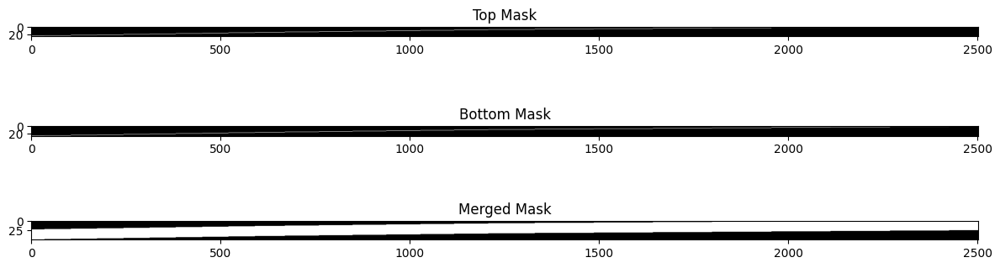

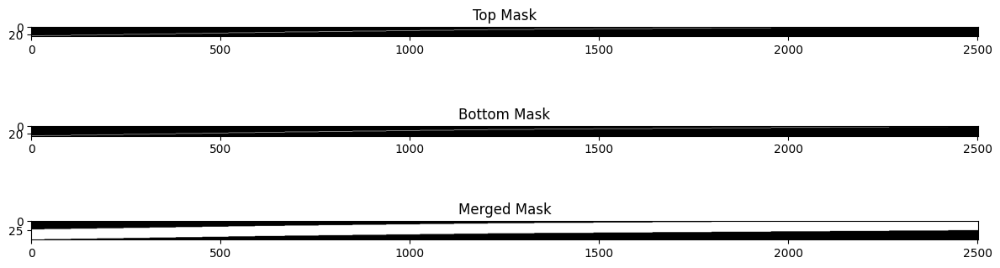

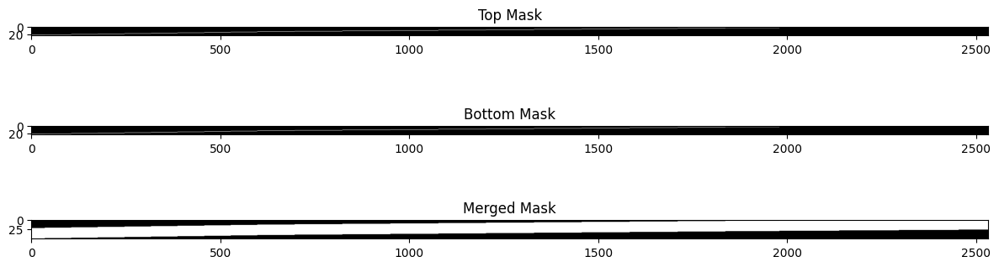

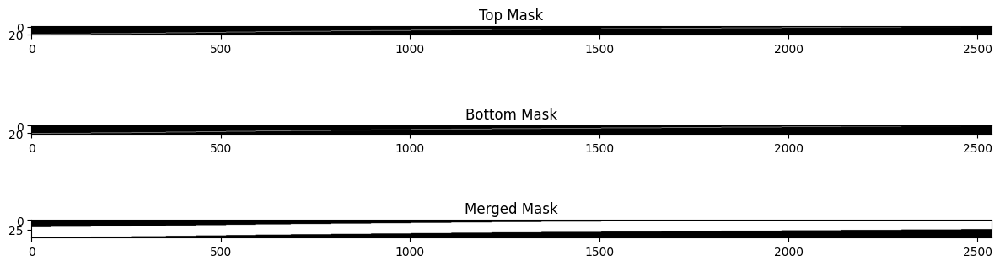

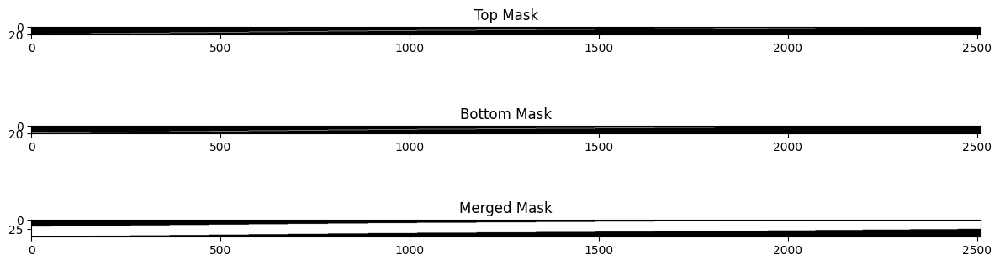

...

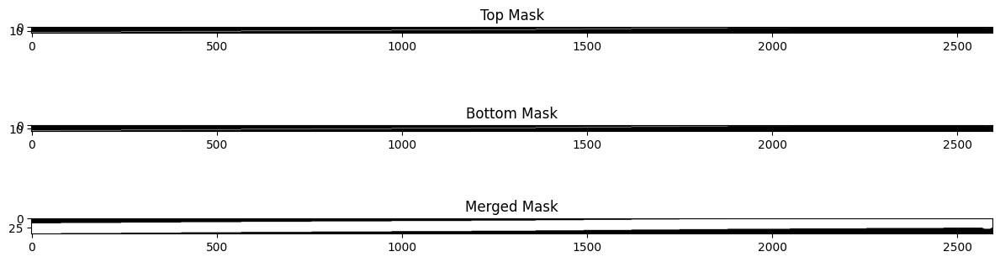

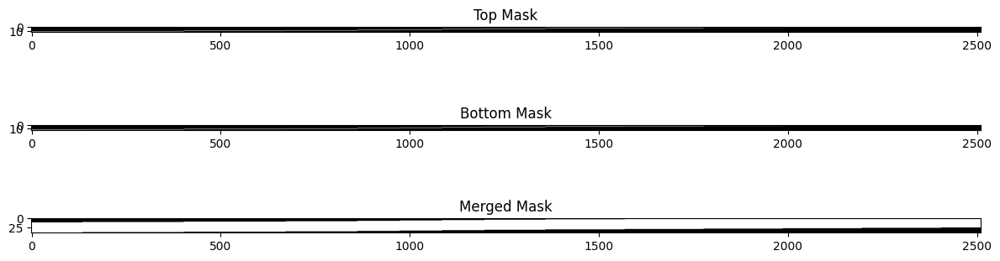

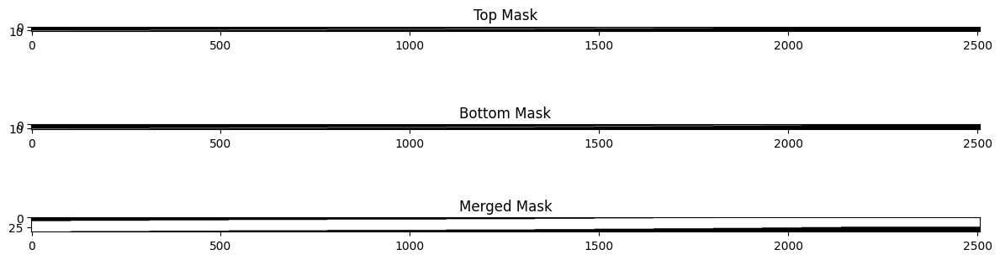

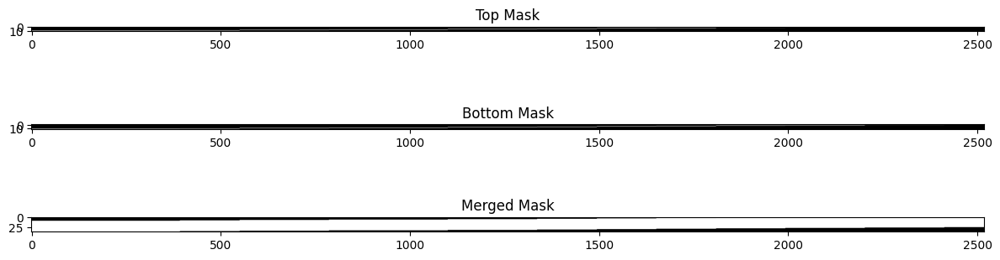

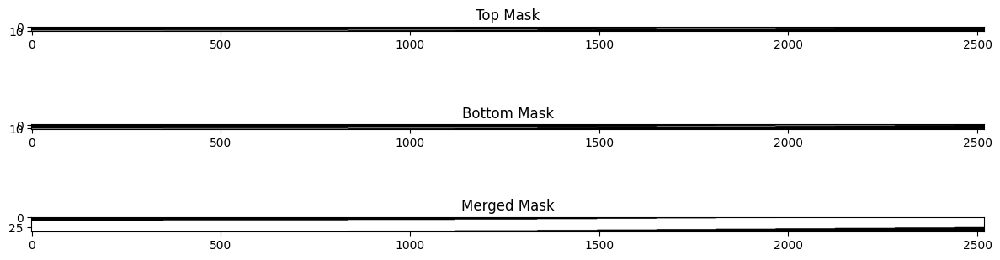

INFO:root:Added 72 staffspaces


In [221]:
import numpy as np

import numpy as np


def merge_and_interpolate_top_bottom_masks(
        top_mask: np.ndarray,
        top_y: int,
        bottom_mask: np.ndarray,
        bottom_y: int,
        visualize: bool = False
) -> np.ndarray:
    height_top, width = top_mask.shape
    height_bottom, width2 = bottom_mask.shape

    if width != width2:
        raise ValueError("Masks must have the same width")
    if top_y > bottom_y:
        raise ValueError("Top mask must be higher than bottom mask")

    y_min = min(top_y, bottom_y)
    y_max = max(top_y + height_top, bottom_y + height_bottom)
    total_height = y_max - y_min

    top_offset = top_y - y_min
    bottom_offset = bottom_y - y_min

    top_canvas = np.zeros((total_height, width), dtype=bool)
    bottom_canvas = np.zeros((total_height, width), dtype=bool)
    top_canvas[top_offset:top_offset + height_top] = top_mask
    bottom_canvas[bottom_offset:bottom_offset + height_bottom] = bottom_mask

    # Get first occurrence of 1 (top) and last (bottom) for each column
    top_pos = np.argmax(top_canvas, axis=0)
    no_top = ~np.any(top_canvas, axis=0)
    top_pos[no_top] = -1

    bottom_pos = total_height - 1 - np.argmax(bottom_canvas[::-1], axis=0)
    no_bottom = ~np.any(bottom_canvas, axis=0)
    bottom_pos[no_bottom] = -1

    def interpolate(arr):
        result = arr.copy()
        known = np.where(arr != -1)[0]
        if len(known) == 0:
            return result
        result[:known[0]] = arr[known[0]]
        result[known[-1] + 1:] = arr[known[-1]]
        for i in range(len(known) - 1):
            start, end = known[i], known[i + 1]
            result[start:end + 1] = np.round(np.linspace(arr[start], arr[end], end - start + 1)).astype(int)
        return result

    top_pos = interpolate(top_pos)
    bottom_pos = interpolate(bottom_pos)

    # Construct output mask with vectorized fill
    rows = np.arange(total_height)[:, None]
    mask = (rows >= top_pos) & (rows <= bottom_pos)
    mask &= (top_pos != -1) & (bottom_pos != -1)  # ensure valid columns only

    mask = mask.astype(np.uint8)

    if visualize:
        import matplotlib.pyplot as plt

        fig, axs = plt.subplots(3, 1, figsize=(12, 4))
        axs[0].imshow(top_mask, cmap="gray")
        axs[0].set_title("Top Mask")
        axs[1].imshow(bottom_mask, cmap="gray")
        axs[1].set_title("Bottom Mask")
        axs[2].imshow(mask, cmap="gray")
        axs[2].set_title("Merged Mask")

        plt.tight_layout()
        plt.show()

    return mask


def crop_node_masks_to_horizontal_overlap(node1: Node, node2: Node):
    left_start = max(node1.left, node2.left)
    right_end = min(node1.right, node2.right)
    if left_start >= right_end:
        logging.warning(f"Given nodes {node1.id}, {node2.id} do not vertically overlap")
        return None

    mask1 = node1.mask[..., left_start - node1.left: node1.mask.shape[1] - (node1.right - right_end)]
    mask2 = node2.mask[..., left_start - node2.left: node2.mask.shape[1] - (node2.right - right_end)]

    # New masks should have the same length
    assert mask1.shape[1] == mask2.shape[1]

    return mask1, mask2


from dataclasses import dataclass


@dataclass(frozen=True)
class _StaffspaceData:
    mask: np.ndarray
    top: int
    left: int


class _StaffWrapper:
    def __init__(self, staff: Node, stafflines: list[Node]):
        if len(stafflines) % WESTERN_NOTATION_STAFF_LINE_COUNT != 0:
            raise StafflineCountNotMultiple()
        if not all(x.class_name == InferenceEngineConstants.STAFFLINE for x in stafflines):
            raise ValueError(f"Mismatched class names in {stafflines}")
        if not staff.class_name == InferenceEngineConstants.STAFF:
            raise ValueError(f"Mismatched class name in {staff}")

        self.staff = staff
        self.stafflines = sorted(stafflines, key=lambda x: x.top)

    @property
    def mean_staffline_distance(self) -> int:
        return int(np.diff([x.top for x in self.stafflines]).mean())

    @property
    def parent_id(self) -> int:
        """Returns the id of the parent staff ``Node`` instance"""
        return self.staff.id

    @classmethod
    def from_graph(cls, graph: NotationGraph) -> list[Self]:
        staffs = sorted(graph.filter_vertices(InferenceEngineConstants.STAFF), key=lambda x: x.top)
        output = []
        for staff in staffs:
            output.append(_StaffWrapper(staff, graph.children(staff, InferenceEngineConstants.STAFFLINE)))
        return output

    def _construct_top_staffspace_data(self) -> _StaffspaceData:
        """
        Shift the top staffline by the mean staffspace distance
        and compute the staffspace as a space between these two lines.
        """
        mask1 = self.stafflines[0].mask
        top_y, bottom_y = self.stafflines[0].top, self.stafflines[0].top + self.mean_staffline_distance
        space_mask = merge_and_interpolate_top_bottom_masks(mask1, top_y, mask1, bottom_y)
        return _StaffspaceData(
            mask=space_mask,
            top=self.stafflines[0].top - self.mean_staffline_distance,
            left=self.stafflines[0].left
        )

    def _construct_bottom_staffspace_data(self) -> _StaffspaceData:
        """
        Shift the bottom staffline by the mean staffspace distance
        and compute the staffspace as a space between these two lines.
        """
        mask1 = self.stafflines[-1].mask
        top_y, bottom_y = self.stafflines[-1].top, self.stafflines[-1].top + self.mean_staffline_distance
        space_mask = merge_and_interpolate_top_bottom_masks(mask1, top_y, mask1, bottom_y)
        return _StaffspaceData(
            mask=space_mask,
            top=self.stafflines[-1].top,
            left=self.stafflines[-1].left
        )

    def construct_staffspace_data(self) -> list[_StaffspaceData]:
        data: list[_StaffspaceData] = []
        # Construct top space
        data.append(self._construct_top_staffspace_data())
        # Construct space between two stafflines next to each other
        for index in range(len(self.stafflines) - 1):
            sl1, sl2 = self.stafflines[index], self.stafflines[index + 1]
            top_mask, bottom_mask = crop_node_masks_to_horizontal_overlap(sl1, sl2)
            mask = merge_and_interpolate_top_bottom_masks(top_mask, sl1.top, bottom_mask, sl2.top)
            data.append(_StaffspaceData(mask=mask, top=sl1.top, left=max(sl1.left, sl2.left)))
        # Construct bottom space
        data.append(self._construct_bottom_staffspace_data())

        return data


def build_staffspace_nodes_new(graph: NotationGraph):
    sws = _StaffWrapper.from_graph(graph)
    if len(sws) == 0:
        return NotationGraph(graph.vertices)

    dataset, document = sws[0].staff.dataset, sws[0].staff.document
    next_node_id = graph.next_node_id
    edges_to_add: list[tuple[int, int]] = []
    staffspaces: list[Node] = []

    # Process all staffspaces
    for sw in sws:
        space_data: list[_StaffspaceData] = sw.construct_staffspace_data()
        for space in space_data:
            staffspaces.append(Node(
                id_=next_node_id,
                class_name=InferenceEngineConstants.STAFFSPACE,
                top=space.top,
                left=space.left,
                width=space.mask.shape[1],
                height=space.mask.shape[0],
                document=document,
                dataset=dataset,
                mask=space.mask
            ))
            edges_to_add.append((sw.parent_id, next_node_id))
            next_node_id += 1

    # Complete the graph
    new_graph = NotationGraph(graph.vertices + staffspaces)
    for edge in edges_to_add:
        new_graph.add_edge(*edge)

    logger.info(f"Added {len(edges_to_add)} staffspaces")
    return new_graph


from typing import Self
import numpy as np

graph = build_staffspace_nodes_new(graph)



In [222]:
graph.next_node_id
graph.save_to_file("test.xml")

In [223]:
from mung.io import validate_nodes_graph_structure

validate_nodes_graph_structure(graph.vertices)

True